# **Detectron2 con dos modelos entrenadores**

## Realizado por Ismael Franco Hernando

### Instalar librerias

In [ ]:
!pip install pyyaml==5.1

     |████████████████████████████████| 274 kB 5.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=71cecf7fb2d5781eba52f739b6d5b14a62fea915216209409384048ac863169c
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 1.0 MB/s 
     |████████████████████████████████| 74 kB 2.4 MB/s 
     |████████████████████████████████| 130 kB 11.2 MB/s 
     |████████████████████████████████| 145 kB 42.9 MB/s 
     |████████████████████████████████| 50 kB 5.8 MB/s 
     |████████████████████████████████| 843 kB 30.2 MB/s 
     |████████████████████████████████| 749 kB 41.7 MB/s 
     |████████████████████████████████| 112 kB 37.0 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220305-py3-none-any.whl size=61214 sha256=e7338328b149d3618e54f4190d38d9e0facbf3e006c4b89cc7e0184ebf35a6ac
  Stored in directory: /root/.cache/pip/wheels/b5/b7/6e/43b1693d06fac3633af48db68557513b0a37ab38b0a8b798f9
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=768219df5a8301059982583a27c37733f4cd72249b439ed4750d7bb2ad2ed

### Imports

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Librerias de uso común
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# Utilidades del detectron2
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode
from detectron2 import structures
from detectron2.structures.boxes import Boxes

## Función que transforma los archivos json al estándar COCO

In [ ]:
def conversor_COCO(directorio):
    #Leemos todos los archivos del directorio y guardamos el nombre de los .json
    ficheros_JSON=[]
    for fichero in os.listdir(directorio):
        if fichero.endswith('.json'):
            ficheros_JSON.append(fichero)
    
    dataset=[]
    #Recorremos cada fichero
    for fichero in ficheros_JSON:
        f_json=os.path.join(directorio, fichero) #Cargamos la ruta de cada fichero
        with open(f_json) as f: #Cargamos el fichero
            json_cargado = json.load(f)
        
        diccionario={}
        key_fichero=list(json_cargado.keys())[0]
        
        #ruta_imagen = os.path.join(directorio, json_cargado[key_fichero]['filename'])        
        ruta_imagen = os.path.join(directorio, fichero[:-7]+".png")
        altura=cv2.imread(ruta_imagen).shape[0]
        anchura=cv2.imread(ruta_imagen).shape[1]
        
        diccionario["file_name"] = ruta_imagen
        diccionario["height"] = altura
        diccionario["width"] = anchura
        
        valores=[]
        regiones=json_cargado[key_fichero]['regions'] 

        for i in range(len(regiones)):
            puntos_x=regiones[i]['shape_attributes']['all_points_x']
            puntos_y=regiones[i]['shape_attributes']['all_points_y']
            forma = [(x, y) for x, y in zip(puntos_x, puntos_y)] 
            forma = [p for x in forma for p in x]
            
            valor= {"bbox": [np.min(puntos_x),np.min(puntos_y),np.max(puntos_x),np.max(puntos_y)],
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation": [forma],
                    "category_id": 0}
            
            valores.append(valor)
        diccionario["annotations"] = valores
        dataset.append(diccionario)
    return dataset    

# Entrenamos el Diente

In [ ]:
clases = ['diente']

for d in ["train", "test", "val"]:
    DatasetCatalog.register("dientes_" + d, lambda d=d: conversor_COCO("dientes_"+d+"/"))
    MetadataCatalog.get("dientes_" + d).set(thing_classes=clases)

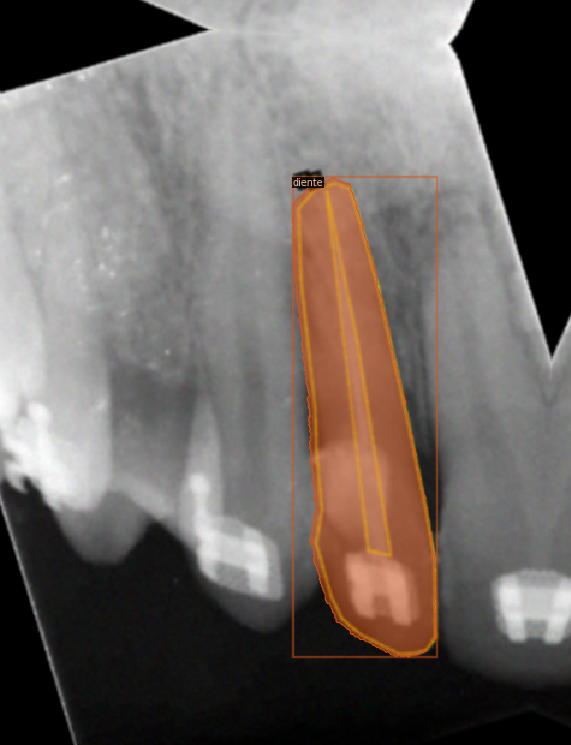

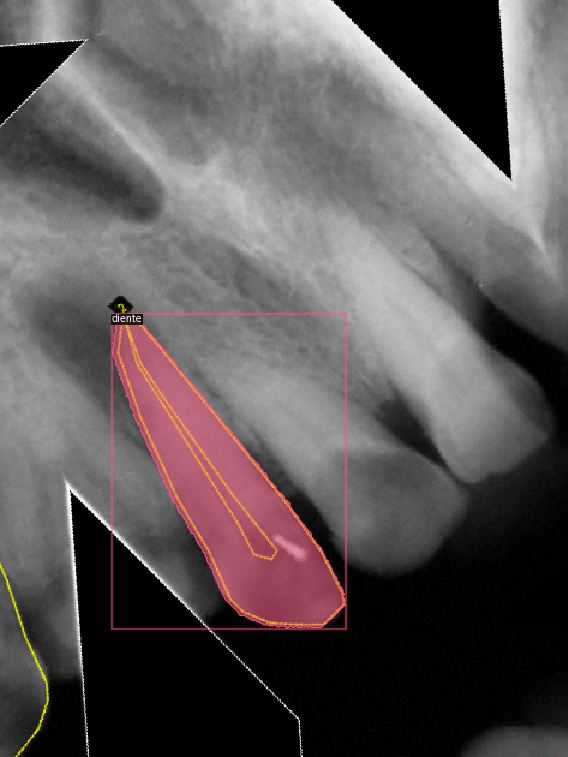

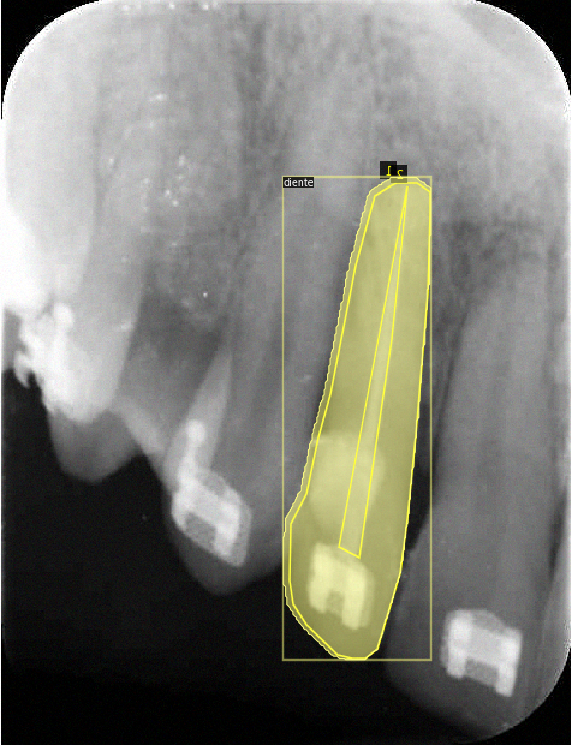

In [ ]:
dientes_metadata = MetadataCatalog.get("dientes_train")
dataset_train_di = conversor_COCO("dientes_train/")

for d in random.sample(dataset_train_di, 3):    
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=dientes_metadata, scale=1.2)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1]) 

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dientes_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 300
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.TEST.DTECTIONS_PER_IMAGE=1

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/23 12:07:22 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 74.5MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[03/23 12:07:30 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/23 12:07:57 d2.utils.events]:  eta: 0:06:15  iter: 19  total_loss: 1.435  loss_cls: 0.6247  loss_box_reg: 0.09659  loss_mask: 0.6874  loss_rpn_cls: 0.01288  loss_rpn_loc: 0.01171  time: 1.3158  data_time: 0.0227  lr: 1.6068e-05  max_mem: 2337M
[03/23 12:08:24 d2.utils.events]:  eta: 0:05:55  iter: 39  total_loss: 1.182  loss_cls: 0.3684  loss_box_reg: 0.1171  loss_mask: 0.6487  loss_rpn_cls: 0.009416  loss_rpn_loc: 0.01128  time: 1.3485  data_time: 0.0109  lr: 3.2718e-05  max_mem: 2337M
[03/23 12:08:51 d2.utils.events]:  eta: 0:05:28  iter: 59  total_loss: 0.8816  loss_cls: 0.1785  loss_box_reg: 0.1221  loss_mask: 0.5597  loss_rpn_cls: 0.003094  loss_rpn_loc: 0.008675  time: 1.3482  data_time: 0.0123  lr: 4.9367e-05  max_mem: 2337M
[03/23 12:09:18 d2.utils.events]:  eta: 0:05:00  iter: 79  total_loss: 0.7156  loss_cls: 0.1313  loss_box_reg: 0.1355  loss_mask: 0.419  loss_rpn_cls: 0.003568  loss_rpn_loc: 0.006728  time: 1.3502  data_time: 0.0095  lr: 6.6017e-05  max_mem: 2337M
[03/2

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


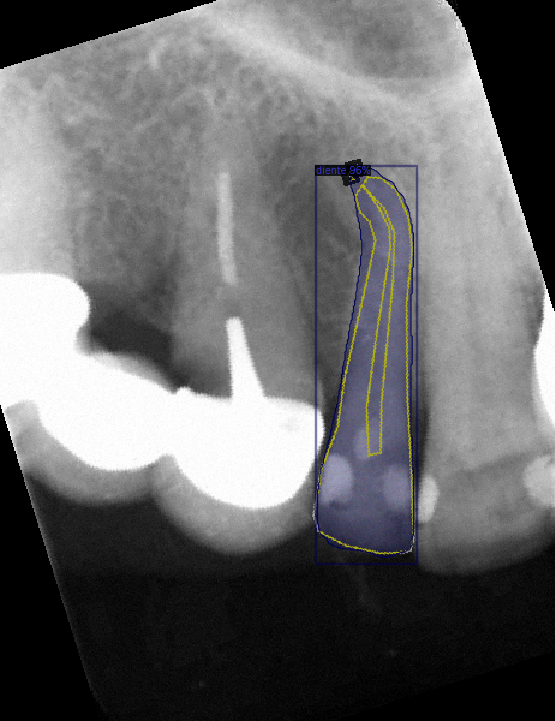

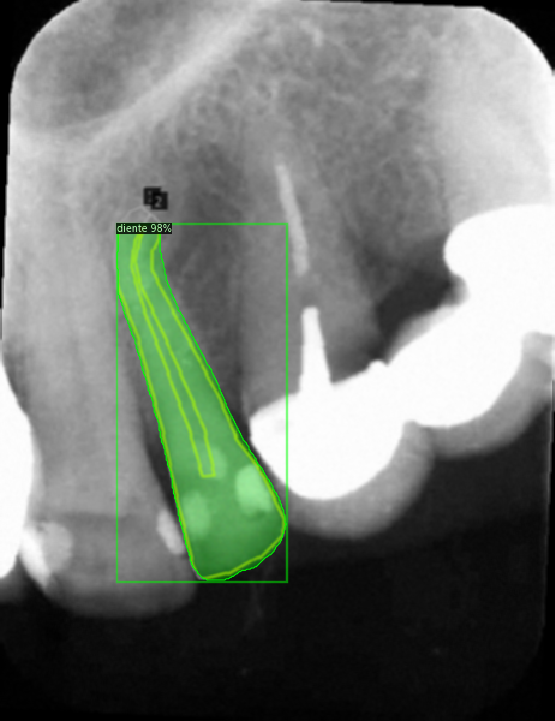

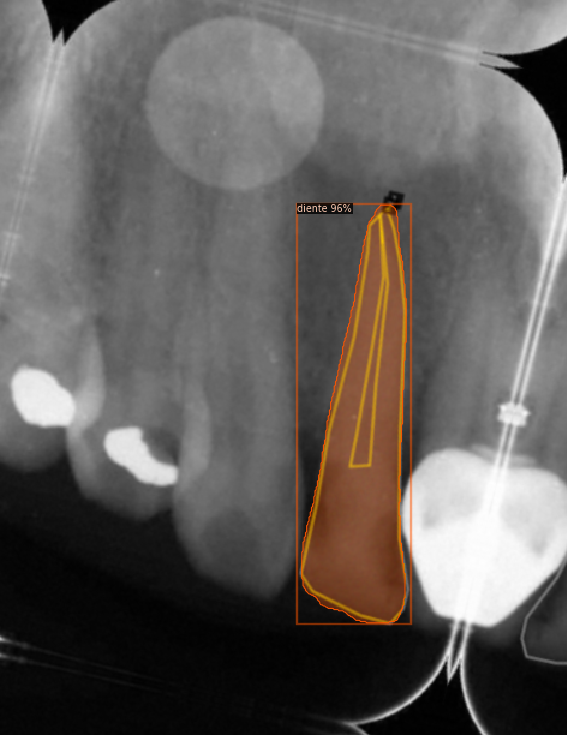

In [ ]:
dataset_test_di = conversor_COCO("dientes_test/")

for d in random.sample(dataset_test_di, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im) 
    v = Visualizer(im[:, :, ::-1],metadata=dientes_metadata,scale=1.2,instance_mode=ColorMode.IMAGE_BW)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1]) 

## Validación 

In [ ]:
from detectron2.engine import HookBase
from detectron2.data import build_detection_train_loader
import detectron2.utils.comm as comm

cfg.DATASETS.VAL = ("dientes_val",)


class ValidationLoss(HookBase):
    def __init__(self, cfg):
        super().__init__()
        self.cfg = cfg.clone()
        self.cfg.DATASETS.TRAIN = cfg.DATASETS.VAL
        self._loader = iter(build_detection_train_loader(self.cfg))
        
    def after_step(self):
        data = next(self._loader)
        with torch.no_grad():
            loss_dict = self.trainer.model(data)
            
            losses = sum(loss_dict.values())
            assert torch.isfinite(losses).all(), loss_dict

            loss_dict_reduced = {"val_" + k: v.item() for k, v in 
                                 comm.reduce_dict(loss_dict).items()}
            losses_reduced = sum(loss for loss in loss_dict_reduced.values())
            if comm.is_main_process():
                self.trainer.storage.put_scalars(total_val_loss=losses_reduced, **loss_dict_reduced)

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
val_loss = ValidationLoss(cfg)  
trainer.register_hooks([val_loss])
# swap the order of PeriodicWriter and ValidationLoss
trainer._hooks = trainer._hooks[:-2] + trainer._hooks[-2:][::-1]
trainer.resume_or_load(resume=False)
trainer.train()

[03/23 12:20:48 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[03/23 12:21:28 d2.utils.events]:  eta: 0:06:20  iter: 19  total_loss: 0.105  loss_cls: 0.01899  loss_box_reg: 0.03197  loss_mask: 0.04639  loss_rpn_cls: 3.67e-05  loss_rpn_loc: 0.00442  total_val_loss: 0.2535  val_loss_cls: 0.06477  val_loss_box_reg: 0.07806  val_loss_mask: 0.1008  val_loss_rpn_cls: 1.535e-05  val_loss_rpn_loc: 0.006124  time: 1.3459  data_time: 0.0177  lr: 1.6068e-05  max_mem: 2504M
[03/23 12:22:07 d2.utils.events]:  eta: 0:05:57  iter: 39  total_loss: 0.09836  loss_cls: 0.02012  loss_box_reg: 0.02999  loss_mask: 0.04344  loss_rpn_cls: 1.653e-05  loss_rpn_loc: 0.004243  total_val_loss: 0.2496  val_loss_cls: 0.0638  val_loss_box_reg: 0.0771  val_loss_mask: 0.1019  val_loss_rpn_cls: 6.937e-05  val_loss_rpn_loc: 0.006086  time: 1.3485  data_time: 0.0095  lr: 3.2718e-05  max_mem: 2504M
[03/23 12:22:45 d2.utils.events]:  eta: 0:05:28  iter: 59  total_loss: 0.1005  loss_cls: 0.01864  loss_box_reg: 0.02996  loss_mask: 0.04549  loss_rpn_cls: 1.367e-05  loss_rpn_loc: 0.003318

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Recortamos el Diente

In [ ]:
def recorta_dientes(dataset_dicts,directorio_salida,directorio_json,mostrar=False):
  if not os.path.isdir(directorio_salida):
      os.makedirs(directorio_salida,exist_ok=True)

  for dic in dataset_dicts:
    nombre_foto=dic["file_name"]
    nombre=nombre_foto.split("/")
    img = cv2.imread(nombre_foto)
    caja=dic["annotations"][0]["bbox"]    
    recorta_imagen(img,caja,nombre[1],directorio_salida,mostrar)
    actualiza_JSON(directorio_json,directorio_salida,nombre[1][:-4]+'_2.json',caja[0],caja[1])

In [ ]:
def recorta_dientes_test(dataset_dicts,directorio_salida,directorio_json,mostrar=False):
  if not os.path.isdir(directorio_salida):
      os.makedirs(directorio_salida,exist_ok=True)

  for dic in dataset_dicts:
    nombre_foto=dic["file_name"]
    nombre=nombre_foto.split("/")
    img = cv2.imread(nombre_foto)
    outputs = predictor(img)
    predicciones=outputs["instances"].pred_boxes.to("cpu")
    caja=predicciones.tensor.tolist()[0]    
    recorta_imagen(img,caja,nombre[1],directorio_salida,mostrar)
    actualiza_JSON(directorio_json,directorio_salida,nombre[1][:-4]+'_2.json',int(caja[0]),int(caja[1]))

In [ ]:
def recorta_imagen(img,caja,nombre_foto,directorio,mostrar=False):
  recorte=img[int(caja[1]):int(caja[3]),int(caja[0]):int(caja[2])]
  if mostrar:
    cv2_imshow(recorte)
  cv2.imwrite(directorio+nombre_foto,recorte)


In [ ]:
def actualiza_JSON(directorio_json,directorio_salida,nombre,origen_x,origen_y):
  f_json=os.path.join(directorio_json, nombre) #Cargamos la ruta del fichero
  with open(f_json) as f: #Cargamos el fichero
    json_cargado = json.load(f)
    key_fichero=list(json_cargado.keys())[0] #Obtenemos la clave del fichero
    ruta_puntos=json_cargado[key_fichero]["regions"][0]["shape_attributes"] #Guardamos la ruta de donde estan los putnos

    #Actualizamos los puntos con el nuevo origne
    puntos_x=np.array(ruta_puntos["all_points_x"])
    puntos_x=puntos_x-origen_x
    puntos_y=np.array(ruta_puntos["all_points_y"])
    puntos_y=puntos_y-origen_y
    
    #Guaradmos los puntos actualizados
    ruta_puntos["all_points_x"]=puntos_x.tolist()
    ruta_puntos["all_points_y"]=puntos_y.tolist()
    
    #Guardamos el nuevo json
    with open(directorio_salida+nombre, 'w') as fichero:
      json.dump(json_cargado, fichero)
    
    

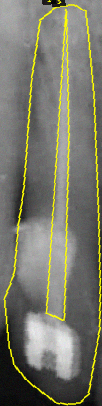

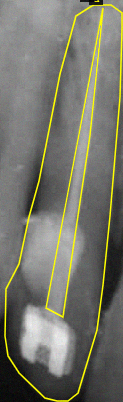

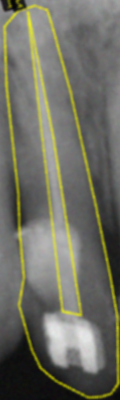

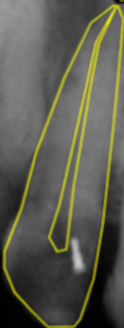

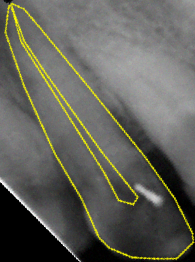

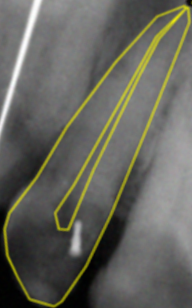

In [ ]:
recorta_dientes(dataset_train_di,'nervios_train/','nervios/',mostrar=True)

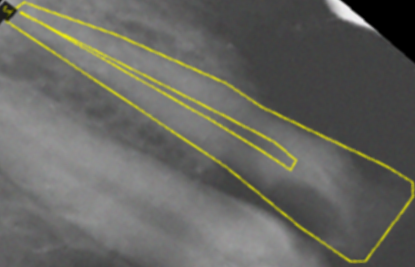

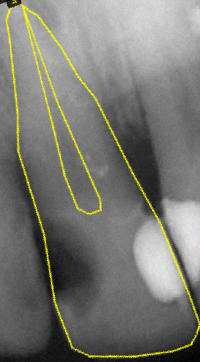

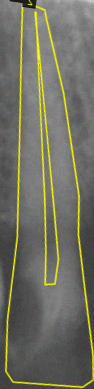

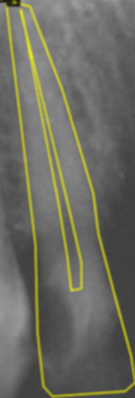

In [ ]:
dataset_val_di = conversor_COCO("dientes_val/")
recorta_dientes(dataset_val_di,'nervios_val/','nervios/',mostrar=True)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


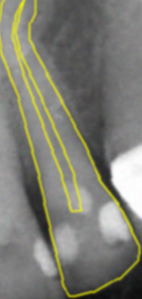

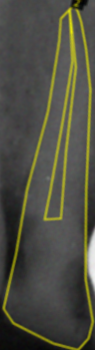

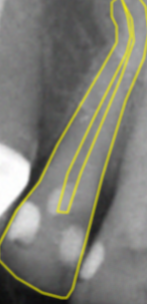

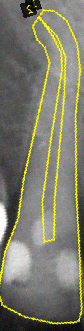

In [ ]:
recorta_dientes_test(dataset_test_di,'nervios_test/','nervios/',mostrar=True)

#Entrenamos el Nervio

In [ ]:
clases = ['nervio']

for d in ["train", "test", "val"]:
    DatasetCatalog.register("nervios_" + d, lambda d=d: conversor_COCO("nervios_"+d+"/"))
    MetadataCatalog.get("nervios_" + d).set(thing_classes=clases)

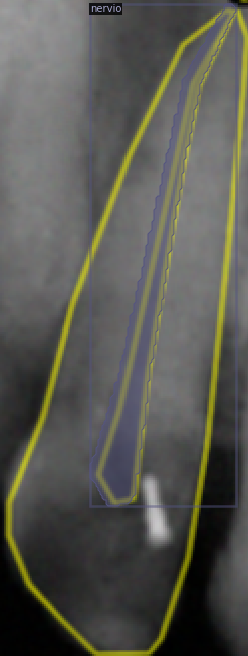

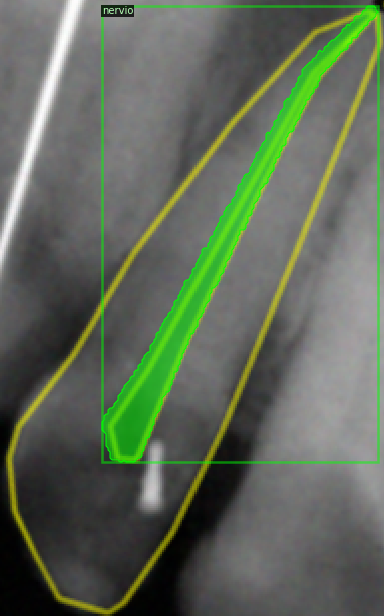

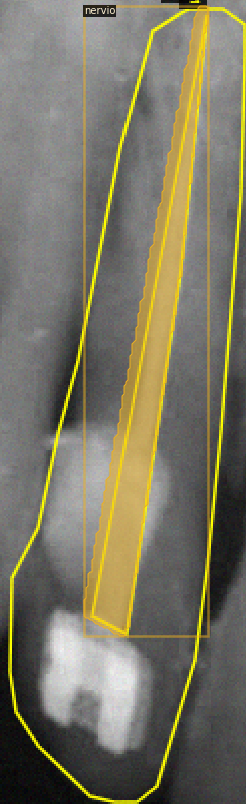

In [ ]:
nervios_metadata = MetadataCatalog.get("nervios_train")
dataset_train_ne = conversor_COCO("nervios_train/")

for d in random.sample(dataset_train_ne, 3):    
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], scale=2,metadata=nervios_metadata)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1]) 

In [ ]:
cfg2 = get_cfg()
cfg2.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg2.DATASETS.TRAIN = ("nervios_train",)
cfg2.DATASETS.TEST = ()
cfg2.DATALOADER.NUM_WORKERS = 2
cfg2.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg2.SOLVER.IMS_PER_BATCH = 2
cfg2.SOLVER.BASE_LR = 0.00025
cfg2.SOLVER.MAX_ITER = 220
cfg2.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg2.TEST.DTECTIONS_PER_IMAGE=1

In [ ]:
os.makedirs(cfg2.OUTPUT_DIR, exist_ok=True)
trainer2 = DefaultTrainer(cfg2) 
trainer2.resume_or_load(resume=False)
trainer2.train()

[03/23 14:35:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[03/23 14:35:19 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[03/23 14:35:49 d2.utils.events]:  eta: 0:05:06  iter: 19  total_loss: 1.411  loss_cls: 0.5994  loss_box_reg: 0.04348  loss_mask: 0.6955  loss_rpn_cls: 0.01029  loss_rpn_loc: 0.03451  time: 1.4722  data_time: 0.0170  lr: 2.1819e-05  max_mem: 3606M
[03/23 14:36:17 d2.utils.events]:  eta: 0:04:39  iter: 39  total_loss: 0.9833  loss_cls: 0.2312  loss_box_reg: 0.06144  loss_mask: 0.6008  loss_rpn_cls: 0.007775  loss_rpn_loc: 0.03064  time: 1.4543  data_time: 0.0091  lr: 4.4524e-05  max_mem: 3606M
[03/23 14:36:46 d2.utils.events]:  eta: 0:04:01  iter: 59  total_loss: 0.7182  loss_cls: 0.09849  loss_box_reg: 0.07751  loss_mask: 0.4849  loss_rpn_cls: 0.00204  loss_rpn_loc: 0.02214  time: 1.4519  data_time: 0.0089  lr: 6.7228e-05  max_mem: 3606M
[03/23 14:37:16 d2.utils.events]:  eta: 0:03:37  iter: 79  total_loss: 0.6205  loss_cls: 0.08024  loss_box_reg: 0.08837  loss_mask: 0.4156  loss_rpn_cls: 0.001232  loss_rpn_loc: 0.02026  time: 1.4541  data_time: 0.0097  lr: 8.9933e-05  max_mem: 3606M
[

In [ ]:
cfg2.MODEL.WEIGHTS = os.path.join(cfg2.OUTPUT_DIR, "model_final.pth")
cfg2.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor2 = DefaultPredictor(cfg2)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


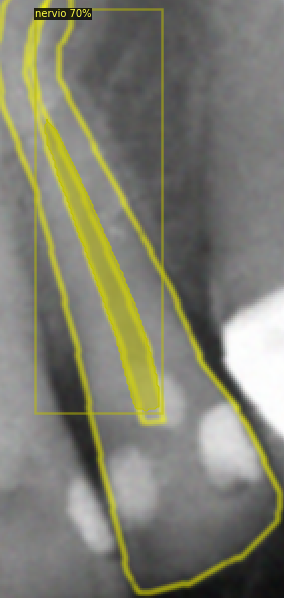

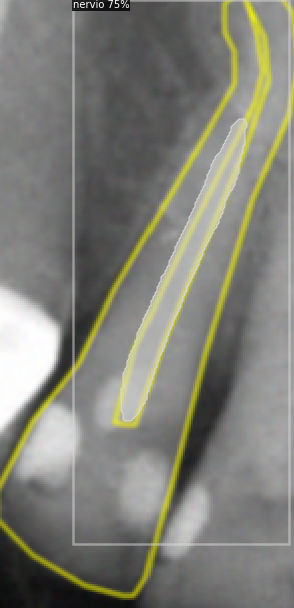

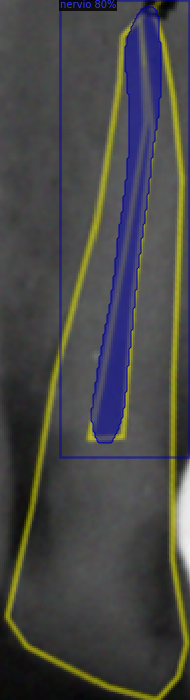

In [ ]:
dataset_test_ne = conversor_COCO("nervios_test/")

for d in random.sample(dataset_test_ne, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor2(im) 
    v = Visualizer(im[:, :, ::-1],metadata=nervios_metadata,scale=2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1]) 

## Validación

In [ ]:
cfg2.DATASETS.VAL = ("nervios_val",)
cfg2.SOLVER.MAX_ITER = 3000

os.makedirs(cfg2.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg2) 
val_loss = ValidationLoss(cfg2)  
trainer.register_hooks([val_loss])
# swap the order of PeriodicWriter and ValidationLoss
trainer._hooks = trainer._hooks[:-2] + trainer._hooks[-2:][::-1]
trainer.resume_or_load(resume=False)
trainer.train()

[03/23 12:44:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[03/23 12:44:56 d2.utils.events]:  eta: 1:13:12  iter: 19  total_loss: 0.2686  loss_cls: 0.03921  loss_box_reg: 0.1227  loss_mask: 0.09053  loss_rpn_cls: 6.47e-05  loss_rpn_loc: 0.01118  total_val_loss: 0.5356  val_loss_cls: 0.04831  val_loss_box_reg: 0.1343  val_loss_mask: 0.3289  val_loss_rpn_cls: 8.147e-05  val_loss_rpn_loc: 0.03652  time: 1.4775  data_time: 0.0211  lr: 4.9953e-06  max_mem: 3605M
[03/23 12:45:38 d2.utils.events]:  eta: 1:12:51  iter: 39  total_loss: 0.2706  loss_cls: 0.03705  loss_box_reg: 0.114  loss_mask: 0.09901  loss_rpn_cls: 0.0002641  loss_rpn_loc: 0.00864  total_val_loss: 0.5204  val_loss_cls: 0.05223  val_loss_box_reg: 0.1358  val_loss_mask: 0.2938  val_loss_rpn_cls: 0.0002326  val_loss_rpn_loc: 0.03424  time: 1.4616  data_time: 0.0094  lr: 9.9902e-06  max_mem: 3605M
[03/23 12:46:19 d2.utils.events]:  eta: 1:12:05  iter: 59  total_loss: 0.2644  loss_cls: 0.03724  loss_box_reg: 0.1074  loss_mask: 0.09973  loss_rpn_cls: 0.0001874  loss_rpn_loc: 0.007756  total

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 443), started 1:56:59 ago. (Use '!kill 443' to kill it.)

<IPython.core.display.Javascript object>